In [14]:
import torch
from transformers import (
    LlavaForConditionalGeneration,
)
import outlines
model_name="mistral-community/pixtral-12b" # original magnet model is able to be loaded without issue
model_class=LlavaForConditionalGeneration

def get_vision_model(model_name: str, model_class):
    model_kwargs = {
        "torch_dtype": torch.bfloat16,
        "device_map": "auto",
    }
    processor_kwargs = {
        "device": "mps",
    }

    model = outlines.models.transformers_vision(
        model.model_name,
        model_class=model_class,
        model_kwargs=model_kwargs,
        processor_kwargs=processor_kwargs,
    )
    return model
model = get_vision_model(model_name, model_class)

AttributeError: module 'outlines.models' has no attribute 'transformers_vision'

In [5]:
from pydantic import BaseModel, Field, confloat, constr
from pydantic.types import StringConstraints, PositiveFloat
from typing import List
from typing_extensions import Annotated

from enum import StrEnum
class TagType(StrEnum):
    ENTITY = "Entity"
    RELATIONSHIP = "Relationship"
    STYLE = "Style"
    ATTRIBUTE = "Attribute"
    COMPOSITION = "Composition"
    CONTEXTUAL = "Contextual"
    TECHNICAL = "Technical"
    SEMANTIC = "Semantic"

class ImageTag(BaseModel):
    tag: Annotated[
        constr(min_length=1, max_length=30),
        Field(
            description=(
                "Descriptive keyword or phrase representing the tag."
            )
        )
    ]
    category: TagType
    confidence: Annotated[
        confloat(le=1.0),
        Field(
            description=(
                "Confidence score for the tag, between 0 (exclusive) and 1 (inclusive)."
            )
        )
    ]

class ImageData(BaseModel):
    tags_list: List[ImageTag] = Field(..., min_items=8, max_items=20)
    short_caption: Annotated[str, StringConstraints(min_length=10, max_length=150)]
    dense_caption: Annotated[str, StringConstraints(min_length=100, max_length=2048)]


In [4]:
pixtral_instruction = """
<s>[INST]
<Task>You are a structured image analysis agent. Generate comprehensive tag list, caption, and dense caption for an image classification system.</Task>
<TagCategories requirement="You should generate a minimum of 1 tag for each category." confidence="Confidence score for the tag, between 0 (exclusive) and 1 (inclusive).">
- Entity : The content of the image, including the objects, people, and other elements.
- Relationship : The relationships between the entities in the image.
- Style : The style of the image, including the color, lighting, and other stylistic elements.
- Attribute : The most important attributes of the entities and relationships in the image.
- Composition : The composition of the image, including the arrangement of elements.
- Contextual : The contextual elements of the image, including the background, foreground, and other elements.
- Technical : The technical elements of the image, including the camera angle, lighting, and other technical details.
- Semantic : The semantic elements of the image, including the meaning of the image, the symbols, and other semantic details.
<Examples note="These show the expected format as an abstraction.">
{
  "tags_list": [
    {
      "tag": "subject 1",
      "category": "Entity",
      "confidence": 0.98
    },
    {
      "tag": "subject 2",
      "category": "Entity",
      "confidence": 0.95
    },
    {
      "tag": "subject 1 runs from subject 2",
      "category": "Relationship",
      "confidence": 0.90
    },
   }
</Examples>
</TagCategories>
<ShortCaption note="The short caption should be a concise single sentence caption of the image content with a maximum length of 100 characters.">
<DenseCaption note="The dense caption should be a descriptive but grounded narrative paragraph of the image content with high quality narrative prose. It should incorporate elements from each of the tag categories to provide a broad dense caption">\n[IMG][/INST]
""".strip()

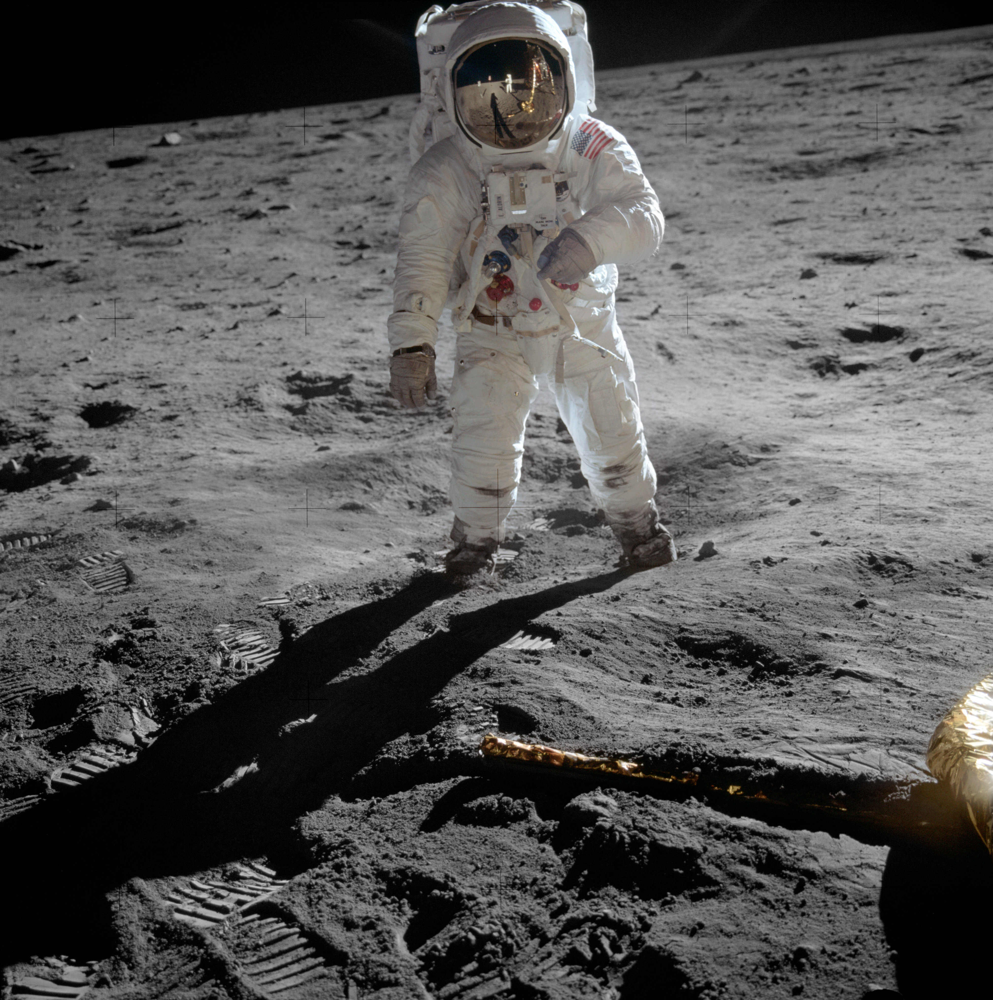

In [11]:
from loguru import logger
from io import BytesIO
from urllib.request import urlopen
from PIL import Image
import base64
import io
def img_from_url(url):
    img_byte_stream = BytesIO(urlopen(url).read())
    return Image.open(img_byte_stream).convert("RGB")

def encode_image(img: Image.Image, max_size: int = None) -> str:


    # Resize image if the longest edge is greater than max_size
    original_size = img.size
    if max_size:
        img.thumbnail((max_size, max_size))
    resized_size = img.size

    if original_size != resized_size:
        logger.info(f"Image resized from {original_size} to {resized_size}")

    buffered = io.BytesIO()
    img.save(buffered, format="PNG")
    return base64.b64encode(buffered.getvalue()).decode('utf-8')



image_url="https://upload.wikimedia.org/wikipedia/commons/9/98/Aldrin_Apollo_11_original.jpg"
image= img_from_url(image_url)
display(image)
encoded_image = encode_image(image)

In [12]:
response = openai_client.beta.chat.completions.parse(
    model=model_name,
    messages=[  
        # {"role": "system", "content": pixtral_instruction},
        {"role": "user", 
         "content": [
             {"type": "text", "text": "What is this image?"},
             {"type": "image_url", "image_url": {"url": f"data:image/png;base64,{encoded_image}"}}
         ]
        }],
    response_format=ImageData
)
print(response.choices[0].message.parsed)

KeyboardInterrupt: 